# Gene expression & surface protein TIL 

## Divide adata into: Protein and RNA 

In [1]:
# Libraries
import anndata as ad
import matplotlib as plt
import numpy as np
import pandas as pd
import sc_atlas_helpers as ah
import scanpy as sc
from matplotlib.pyplot import rc_context
from scipy.stats import median_abs_deviation

/home/kvalem/.local/lib/python3.11/site-packages/numba/core/cpu.py:99: UserWarning: Numba extension module 'awkward.numba' failed to load due to 'ModuleNotFoundError(No module named 'importlib_metadata')'.
  numba.core.entrypoints.init_all()


In [2]:
from functools import partial

import altair as alt

In [3]:
import seaborn as sns

In [4]:
import decoupler as dc

In [5]:
alt.renderers.enable("png")
alt.data_transformers.disable_max_rows()

DataTransformerRegistry.enable('default')

In [6]:
resDir = "/data/projects/2021/MicrobialMetabolites/single-cell-sorted-cd8/results/40_gex_surface_prot/"
inputDir = "/data/projects/2021/MicrobialMetabolites/single-cell-sorted-cd8/results/40_gex_surface_prot/"

In [7]:
adata = sc.read_h5ad(f"{resDir}adata_merged_til_all_genes.h5ad")

/home/kvalem/.local/lib/python3.11/site-packages/anndata/_core/anndata.py:1818: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [8]:
adata

AnnData object with n_obs × n_vars = 72592 × 32290
    obs: 'adata_name', 'condition', 'batch_id', 'sample_id'
    var: 'gene_ids', 'feature_types', 'genome', 'pattern', 'read', 'sequence'
    layers: 'counts'

In [9]:
adata.obs

,adata_name,condition,batch_id,sample_id
AAACCTGAGAGCCTAG-1,adata_10mix_ICI1,10mix,ICI1,10mix_ICI1
AAACCTGAGATGTGGC-1,adata_10mix_ICI1,10mix,ICI1,10mix_ICI1
AAACCTGAGCCACGTC-1,adata_10mix_ICI1,10mix,ICI1,10mix_ICI1
AAACCTGAGGCTCTTA-1,adata_10mix_ICI1,10mix,ICI1,10mix_ICI1
AAACCTGAGGGCACTA-1,adata_10mix_ICI1,10mix,ICI1,10mix_ICI1
...,...,...,...,...
TTTGTCATCCCTTGCA-1,adata_GF_ICI2_plus,GF,ICI2,GF_ICI2_plus
TTTGTCATCGTTGCCT-1,adata_GF_ICI2_plus,GF,ICI2,GF_ICI2_plus
TTTGTCATCTAACTGG-1,adata_GF_ICI2_plus,GF,ICI2,GF_ICI2_plus
TTTGTCATCTCTGTCG-1,adata_GF_ICI2_plus,GF,ICI2,GF_ICI2_plus


In [10]:
adata.var[adata.var["gene_ids"]=="ENSMUSG00000060594"]

,gene_ids,feature_types,genome,pattern,read,sequence
Layn,ENSMUSG00000060594,Gene Expression,mm10,,,


In [11]:
adata.var[adata.var["gene_ids"]=="ENSMUSG00000023078"]

,gene_ids,feature_types,genome,pattern,read,sequence
Cxcl13,ENSMUSG00000023078,Gene Expression,mm10,,,


In [12]:
adata.obs_names = (
    adata.obs_names + "_" + adata.obs["sample_id"].astype(str)
)  # to avoid duplicate obs names i combine obs names + sample_id

In [13]:
adata.obs

,adata_name,condition,batch_id,sample_id
AAACCTGAGAGCCTAG-1_10mix_ICI1,adata_10mix_ICI1,10mix,ICI1,10mix_ICI1
AAACCTGAGATGTGGC-1_10mix_ICI1,adata_10mix_ICI1,10mix,ICI1,10mix_ICI1
AAACCTGAGCCACGTC-1_10mix_ICI1,adata_10mix_ICI1,10mix,ICI1,10mix_ICI1
AAACCTGAGGCTCTTA-1_10mix_ICI1,adata_10mix_ICI1,10mix,ICI1,10mix_ICI1
AAACCTGAGGGCACTA-1_10mix_ICI1,adata_10mix_ICI1,10mix,ICI1,10mix_ICI1
...,...,...,...,...
TTTGTCATCCCTTGCA-1_GF_ICI2_plus,adata_GF_ICI2_plus,GF,ICI2,GF_ICI2_plus
TTTGTCATCGTTGCCT-1_GF_ICI2_plus,adata_GF_ICI2_plus,GF,ICI2,GF_ICI2_plus
TTTGTCATCTAACTGG-1_GF_ICI2_plus,adata_GF_ICI2_plus,GF,ICI2,GF_ICI2_plus
TTTGTCATCTCTGTCG-1_GF_ICI2_plus,adata_GF_ICI2_plus,GF,ICI2,GF_ICI2_plus


## Protein

In [14]:
protein = adata[:, adata.var["feature_types"] == "Antibody Capture"].copy()

In [15]:
#protein.obs_names = (
#    protein.obs_names + "_" + protein.obs["sample_id"].astype(str)
#)  # to avoid duplicate obs names i combine obs names + sample_id

In [16]:
protein.var

,gene_ids,feature_types,genome,pattern,read,sequence
PD1_TotalSeqC,PD1,Antibody Capture,,5PNNNNNNNNNN(BC),R2,GAAAGTCAAAGCACT
CD69_TotalSeqC,CD69,Antibody Capture,,5PNNNNNNNNNN(BC),R2,TTGTATTCCGCCATT
CD44_TotalSeqC,CD44,Antibody Capture,,5PNNNNNNNNNN(BC),R2,TGGCTTCAGGTCCTA
ICOS_TotalSeqC,ICOS,Antibody Capture,,5PNNNNNNNNNN(BC),R2,CGCGCACCCATTAAA
CD103_TotalSeqC,CD103,Antibody Capture,,5PNNNNNNNNNN(BC),R2,TTCATTAGCCCGCTG


In [17]:
protein.layers["counts"] = protein.X.copy()

In [18]:
sc.pp.normalize_total(protein)

In [19]:
sc.pp.log1p(protein)

In [20]:
sc.pp.pca(protein)

In [22]:
sc.pp.neighbors(protein)  # why can't we just work with the default neighbors?

In [23]:
sc.tl.leiden(protein, key_added="protein_leiden", n_iterations=2)

/tmp/ipykernel_3020354/1771237451.py:1: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(protein, key_added="protein_leiden", n_iterations=2)


In [24]:
sc.tl.umap(protein)

In [25]:
protein.obsp["protein_connectivities"] = protein.obsp["connectivities"].copy()

In [26]:
protein

AnnData object with n_obs × n_vars = 72592 × 5
    obs: 'adata_name', 'condition', 'batch_id', 'sample_id', 'protein_leiden'
    var: 'gene_ids', 'feature_types', 'genome', 'pattern', 'read', 'sequence'
    uns: 'log1p', 'pca', 'neighbors', 'protein_leiden', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities', 'protein_connectivities'

### Protein - Visualization

In [27]:
# sc.tl.umap(protein)
# sc.pl.umap(protein, color="protein_leiden", size=10)

In [28]:
# sc.pl.umap(protein, color=["PD1_TotalSeqC","CD69_TotalSeqC","CD44_TotalSeqC"], size=10, vmax="p99", vmin=0, cmap="Reds" )

In [29]:
# sc.pl.umap(protein, color=["ICOS_TotalSeqC","CD103_TotalSeqC"], size=10, vmax="p99", vmin=0, cmap="Reds" )

In [30]:
# sc.pl.umap(protein, color="condition", size=10, groups = "11mix")

### RNA

In [31]:
rna = adata[:, adata.var["feature_types"] == "Gene Expression"].copy()

In [32]:
#rna_bottom = adata_bottom[:, adata_bottom.var["feature_types"] == "Gene Expression"].copy()

In [33]:
#rna.obs_names = (
#    rna.obs_names + "_" + rna.obs["sample_id"].astype(str)
#)  # to avoid duplicate obs names i combine obs names + sample_id


In [34]:
rna.layers["counts"] = rna.X.copy()

In [35]:
rna.var[rna.var["gene_ids"]=="ENSMUSG00000060594"]

,gene_ids,feature_types,genome,pattern,read,sequence
Layn,ENSMUSG00000060594,Gene Expression,mm10,,,


In [36]:
rna.var["mito"] = rna.var_names.str.startswith("mt")
rna.var["ribo"] = rna.var_names.str.startswith("rb")
rna.var["hb"] = rna.var_names.str.startswith("hb")
sc.pp.calculate_qc_metrics(
    rna,
    qc_vars=["mito", "ribo", "hb"],
    inplace=True,
    percent_top=[20],
    log1p=True,
)

In [37]:
sc.pp.normalize_total(rna)
sc.pp.log1p(rna)

In [ ]:
#sc.pp.highly_variable_genes(rna, n_top_genes=2000, batch_key="sample_id")

In [38]:
sc.pp.highly_variable_genes(rna, n_top_genes=1000, batch_key="sample_id")

In [39]:
sc.pp.pca(rna)
sc.pp.neighbors(rna, n_neighbors=30)
sc.tl.umap(rna)
sc.tl.leiden(rna, key_added="rna_leiden")

IOStream.flush timed out


In [40]:
sc.tl.leiden(rna, resolution=0.5, key_added="rna_leiden_05")

IOStream.flush timed out


In [41]:
rna

AnnData object with n_obs × n_vars = 72592 × 32285
    obs: 'adata_name', 'condition', 'batch_id', 'sample_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'rna_leiden', 'rna_leiden_05'
    var: 'gene_ids', 'feature_types', 'genome', 'pattern', 'read', 'sequence', 'mito', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'rna_leiden', 'rna_leiden_05'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

In [42]:
sc.pp.filter_genes(rna, min_cells=10)

In [43]:
rna.var[rna.var["gene_ids"]=="ENSMUSG00000060594"]

,gene_ids,feature_types,genome,pattern,read,sequence,mito,ribo,hb,n_cells_by_counts,...,pct_dropout_by_counts,total_counts,log1p_total_counts,highly_variable,means,dispersions,dispersions_norm,highly_variable_nbatches,highly_variable_intersection,n_cells
Layn,ENSMUSG00000060594,Gene Expression,mm10,,,,False,False,False,14,...,99.980714,14.0,2.70805,False,0.000284,0.082715,-0.563609,1,False,14


In [44]:
rna

AnnData object with n_obs × n_vars = 72592 × 17581
    obs: 'adata_name', 'condition', 'batch_id', 'sample_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'rna_leiden', 'rna_leiden_05'
    var: 'gene_ids', 'feature_types', 'genome', 'pattern', 'read', 'sequence', 'mito', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'n_cells'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'rna_leiden', 'rna_leiden_05'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'distances', 'connectivities'

[<Axes: title={'center': 'pct_counts_mito'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <Axes: title={'center': 'total_counts'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <Axes: title={'center': 'n_genes_by_counts'}, xlabel='UMAP1', ylabel='UMAP2'>]

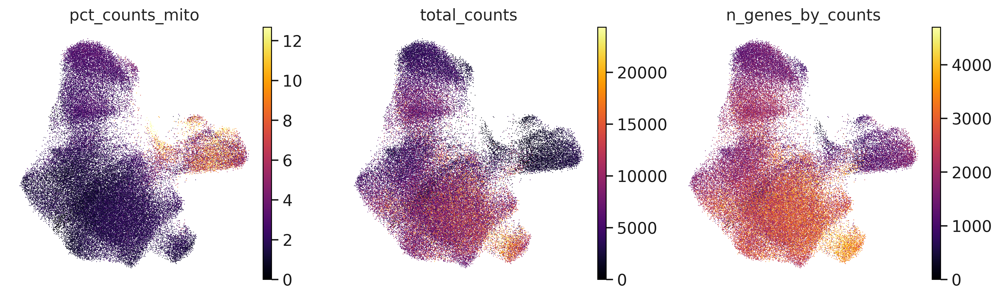

In [45]:
# ah.pl.umap_qc_metrics(rna, vmax_total_counts=20000, vmax_n_genes=2000)
sc.pl.umap(
    rna,
    color=["pct_counts_mito", "total_counts", "n_genes_by_counts"],
    cmap="inferno",
    vmin=0,
    vmax="p99",
    sort_order=False,
    show=False,
)

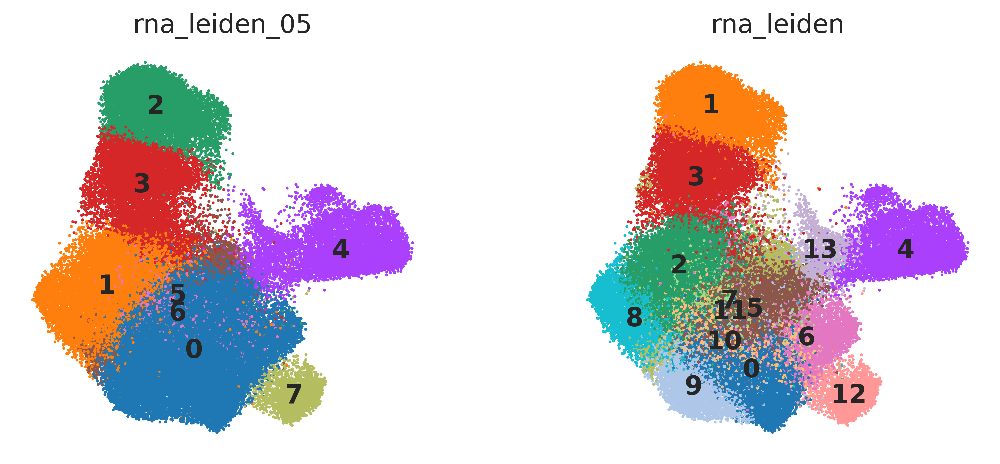

In [46]:
sc.pl.umap(rna, color=["rna_leiden_05", "rna_leiden"], size=10, legend_loc="on data")

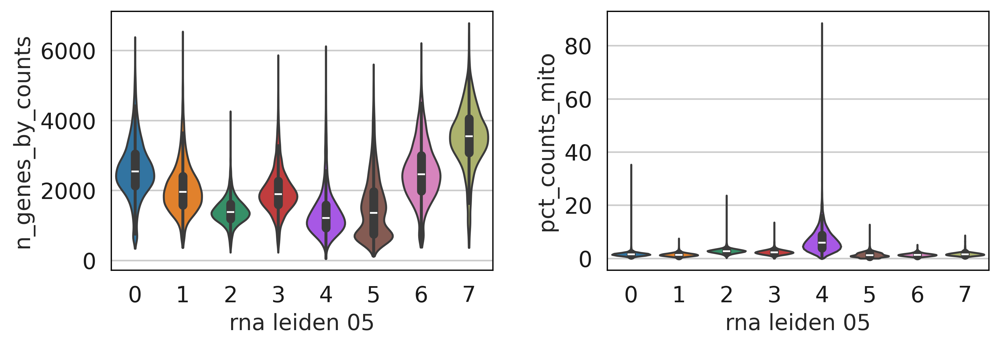

In [47]:
with rc_context({"figure.figsize": (4.5, 3)}):
    sc.pl.violin(
        rna,
        ["n_genes_by_counts", "pct_counts_mito"],
        groupby="rna_leiden_05",
        stripplot=False,  # remove the internal dots
        inner="box",  # adds a boxplot inside violins
    )

In [48]:
## sp
rna.obs["is_outlier_counts"] = ah.pp.is_outlier(
    rna, "log1p_total_counts", n_mads=1.5, groupby="sample_id"
)
rna.obs["is_outlier_genes"] = ah.pp.is_outlier(
    rna, "log1p_n_genes_by_counts", n_mads=1.5, groupby="sample_id"
)
rna.obs["is_outlier_top_20"] = ah.pp.is_outlier(
    rna, "pct_counts_in_top_20_genes", n_mads=1.5, groupby="sample_id"
)
rna.obs["is_outlier_mito"] = ah.pp.is_outlier(
    rna, "pct_counts_mito", n_mads=3, groupby="sample_id"
)

rna.obs["is_outlier"] = (
    np.sum(
        rna.obs.loc[
            :,
            [
                "is_outlier_counts",
                "is_outlier_genes",
                "is_outlier_top_20",
                "is_outlier_mito",
            ],
        ],
        axis=1,
    )
    >= 2
)

In [49]:
rna_filtered = rna[~rna.obs["is_outlier"]].copy()

In [50]:
rna_filtered

AnnData object with n_obs × n_vars = 47019 × 17581
    obs: 'adata_name', 'condition', 'batch_id', 'sample_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'rna_leiden', 'rna_leiden_05', 'is_outlier_counts', 'is_outlier_genes', 'is_outlier_top_20', 'is_outlier_mito', 'is_outlier'
    var: 'gene_ids', 'feature_types', 'genome', 'pattern', 'read', 'sequence', 'mito', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'n_cells'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'rna_leiden', 'rna_leiden_05', 'rna_leiden_05

[<Axes: title={'center': 'pct_counts_mito'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <Axes: title={'center': 'total_counts'}, xlabel='UMAP1', ylabel='UMAP2'>,
 <Axes: title={'center': 'n_genes_by_counts'}, xlabel='UMAP1', ylabel='UMAP2'>]

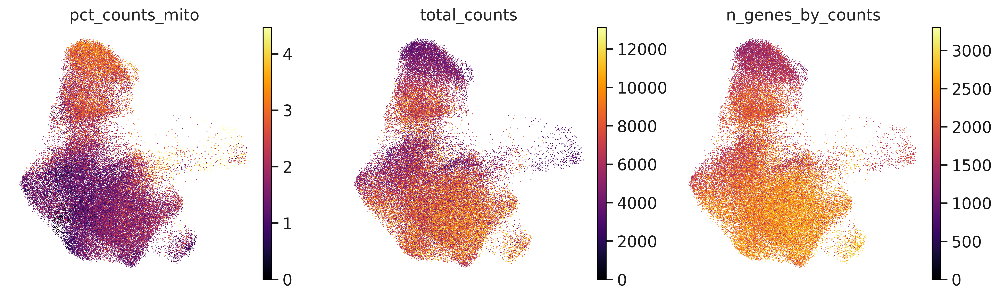

In [51]:
sc.pl.umap(
    rna_filtered,
    color=["pct_counts_mito", "total_counts", "n_genes_by_counts"],
    cmap="inferno",
    vmin=0,
    vmax="p99",
    sort_order=False,
    show=False,
)

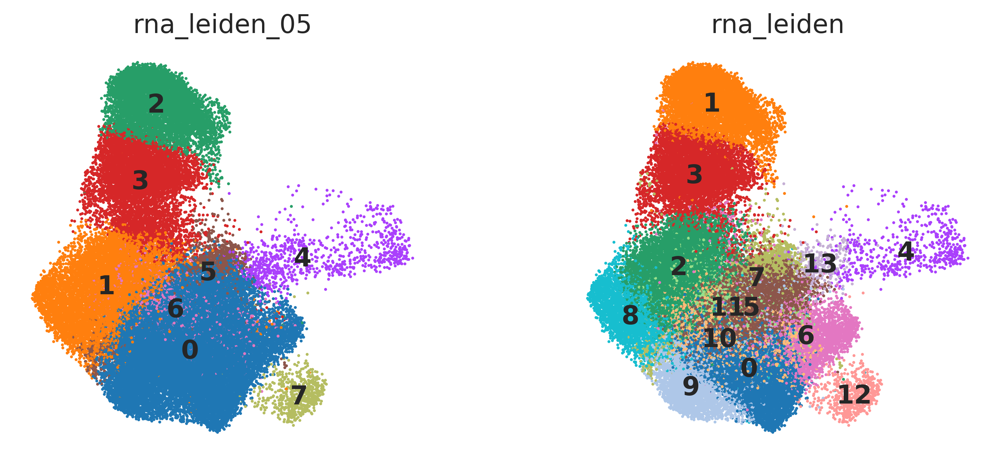

In [52]:
sc.pl.umap(
    rna_filtered, color=["rna_leiden_05", "rna_leiden"], size=10, legend_loc="on data"
)

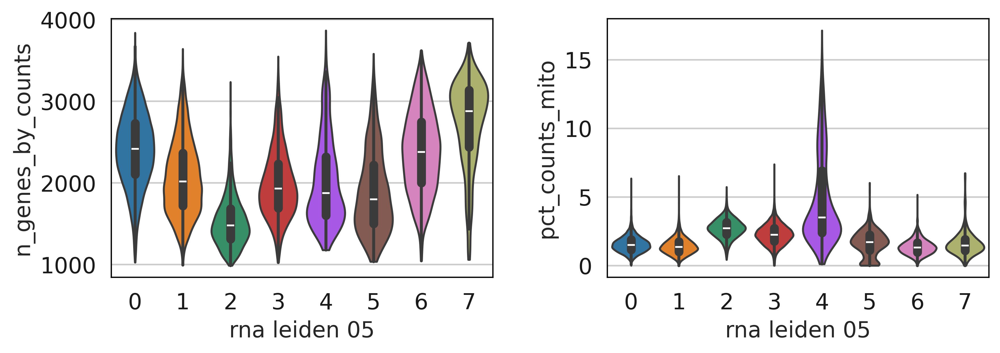

In [53]:
with rc_context({"figure.figsize": (4.5, 3)}):
    sc.pl.violin(
        rna_filtered,
        ["n_genes_by_counts", "pct_counts_mito"],
        groupby="rna_leiden_05",
        stripplot=False,  # remove the internal dots
        inner="box",  # adds a boxplot inside violins
    )

### Visualization RNA & Protein

In [54]:
#### Visualization function
def embedding_chart(df: pd.DataFrame, coord_pat: str, *, size=5) -> alt.Chart:
    """Make schema for coordinates, like sc.pl.embedding."""
    x, y = df.columns[df.columns.str.contains(coord_pat)]
    return (
        alt.Chart(plotdf, height=300, width=300)
        .mark_circle(size=size)
        .encode(
            x=alt.X(x, axis=None),
            y=alt.Y(y, axis=None),
        )
    )


def umap_chart(df: pd.DataFrame, **kwargs) -> alt.Chart:
    """Like sc.pl.umap, but just the coordinates."""
    return embedding_chart(df, "umap", **kwargs)


def encode_color(
    c: alt.Chart, col: str, *, qdomain=(0, 1), scheme: str = "lightgreyred"
) -> alt.Chart:
    """Add colors to an embedding plot schema."""
    base = c.properties(title=col)
    if pd.api.types.is_categorical_dtype(c.data[col]):
        return base.encode(color=col)
    else:
        return base.encode(
            color=alt.Color(
                col,
                scale=alt.Scale(
                    scheme=scheme,
                    clamp=True,
                    domain=list(c.data[col].quantile(qdomain)),
                    nice=True,
                ),
            )
        )

In [55]:
protein.obs

,adata_name,condition,batch_id,sample_id,protein_leiden
AAACCTGAGAGCCTAG-1_10mix_ICI1,adata_10mix_ICI1,10mix,ICI1,10mix_ICI1,26
AAACCTGAGATGTGGC-1_10mix_ICI1,adata_10mix_ICI1,10mix,ICI1,10mix_ICI1,16
AAACCTGAGCCACGTC-1_10mix_ICI1,adata_10mix_ICI1,10mix,ICI1,10mix_ICI1,2
AAACCTGAGGCTCTTA-1_10mix_ICI1,adata_10mix_ICI1,10mix,ICI1,10mix_ICI1,2
AAACCTGAGGGCACTA-1_10mix_ICI1,adata_10mix_ICI1,10mix,ICI1,10mix_ICI1,7
...,...,...,...,...,...
TTTGTCATCCCTTGCA-1_GF_ICI2_plus,adata_GF_ICI2_plus,GF,ICI2,GF_ICI2_plus,10
TTTGTCATCGTTGCCT-1_GF_ICI2_plus,adata_GF_ICI2_plus,GF,ICI2,GF_ICI2_plus,6
TTTGTCATCTAACTGG-1_GF_ICI2_plus,adata_GF_ICI2_plus,GF,ICI2,GF_ICI2_plus,11
TTTGTCATCTCTGTCG-1_GF_ICI2_plus,adata_GF_ICI2_plus,GF,ICI2,GF_ICI2_plus,15


In [56]:
rna.obs

,adata_name,condition,batch_id,sample_id,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_20_genes,total_counts_mito,...,total_counts_hb,log1p_total_counts_hb,pct_counts_hb,rna_leiden,rna_leiden_05,is_outlier_counts,is_outlier_genes,is_outlier_top_20,is_outlier_mito,is_outlier
AAACCTGAGAGCCTAG-1_10mix_ICI1,adata_10mix_ICI1,10mix,ICI1,10mix_ICI1,2513,7.829630,7829.0,8.965717,13.897049,70.0,...,0.0,0.0,0.0,5,0,False,False,False,False,False
AAACCTGAGATGTGGC-1_10mix_ICI1,adata_10mix_ICI1,10mix,ICI1,10mix_ICI1,3022,8.014005,11793.0,9.375346,17.001611,150.0,...,0.0,0.0,0.0,2,1,False,False,False,False,False
AAACCTGAGCCACGTC-1_10mix_ICI1,adata_10mix_ICI1,10mix,ICI1,10mix_ICI1,596,6.391917,1105.0,7.008505,30.588235,108.0,...,0.0,0.0,0.0,13,2,True,True,True,True,True
AAACCTGAGGCTCTTA-1_10mix_ICI1,adata_10mix_ICI1,10mix,ICI1,10mix_ICI1,1470,7.293698,3882.0,8.264363,19.500258,100.0,...,0.0,0.0,0.0,1,2,False,False,True,False,False
AAACCTGAGGGCACTA-1_10mix_ICI1,adata_10mix_ICI1,10mix,ICI1,10mix_ICI1,2209,7.700748,7992.0,8.986321,18.018018,72.0,...,0.0,0.0,0.0,2,1,False,False,True,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTCATCCCTTGCA-1_GF_ICI2_plus,adata_GF_ICI2_plus,GF,ICI2,GF_ICI2_plus,2108,7.653969,6218.0,8.735364,15.937601,136.0,...,0.0,0.0,0.0,0,0,False,False,False,False,False
TTTGTCATCGTTGCCT-1_GF_ICI2_plus,adata_GF_ICI2_plus,GF,ICI2,GF_ICI2_plus,4821,8.480944,25856.0,10.160336,14.948175,493.0,...,0.0,0.0,0.0,10,0,True,True,False,False,True
TTTGTCATCTAACTGG-1_GF_ICI2_plus,adata_GF_ICI2_plus,GF,ICI2,GF_ICI2_plus,1685,7.430114,3886.0,8.265393,13.767370,73.0,...,0.0,0.0,0.0,2,1,True,False,True,False,True
TTTGTCATCTCTGTCG-1_GF_ICI2_plus,adata_GF_ICI2_plus,GF,ICI2,GF_ICI2_plus,2101,7.650645,6973.0,8.849944,17.453033,170.0,...,0.0,0.0,0.0,2,1,False,False,False,False,False


In [57]:
rna.obsm["protein"] = protein.to_df()
rna.obsm["protein_umap"] = protein.obsm["X_umap"]
rna.obs["protein_leiden"] = protein.obs["protein_leiden"]
rna.obsp["rna_connectivities"] = rna.obsp["connectivities"].copy()
rna.obsp["protein_connectivities"] = protein.obsp["protein_connectivities"]

In [58]:
sc.tl.umap(rna)

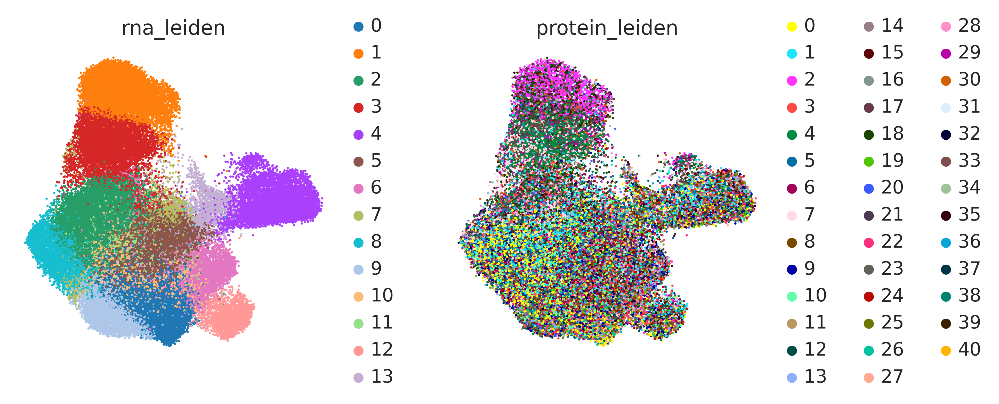

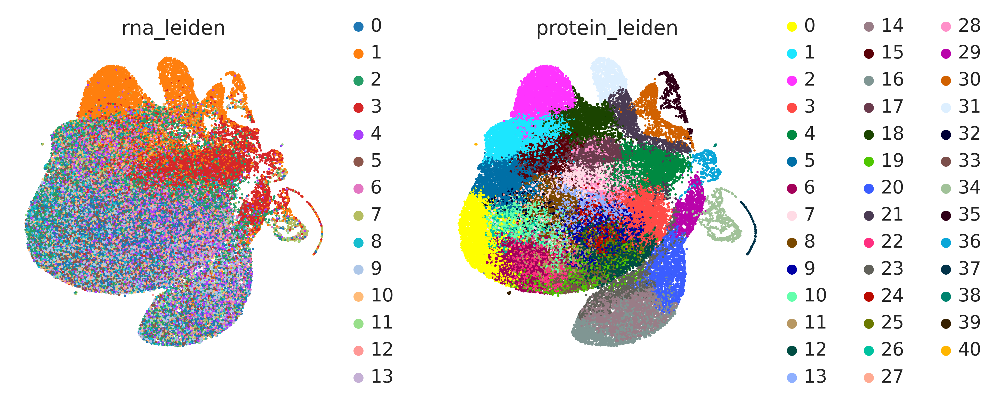

In [59]:
sc.pl.umap(rna, color=["rna_leiden", "protein_leiden"], size=10)
sc.pl.embedding(rna, basis="protein_umap", color=["rna_leiden", "protein_leiden"], size=10)

## Both modalities together

### Visualizing

/tmp/ipykernel_3020354/2938188807.py:25: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(c.data[col]):
/tmp/ipykernel_3020354/2938188807.py:25: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(c.data[col]):
/tmp/ipykernel_3020354/2938188807.py:25: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(c.data[col]):
/tmp/ipykernel_3020354/2938188807.py:25: DeprecationWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, pd.CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(c.data[col]):
/tmp/ipykernel_3020354/2938188807.py

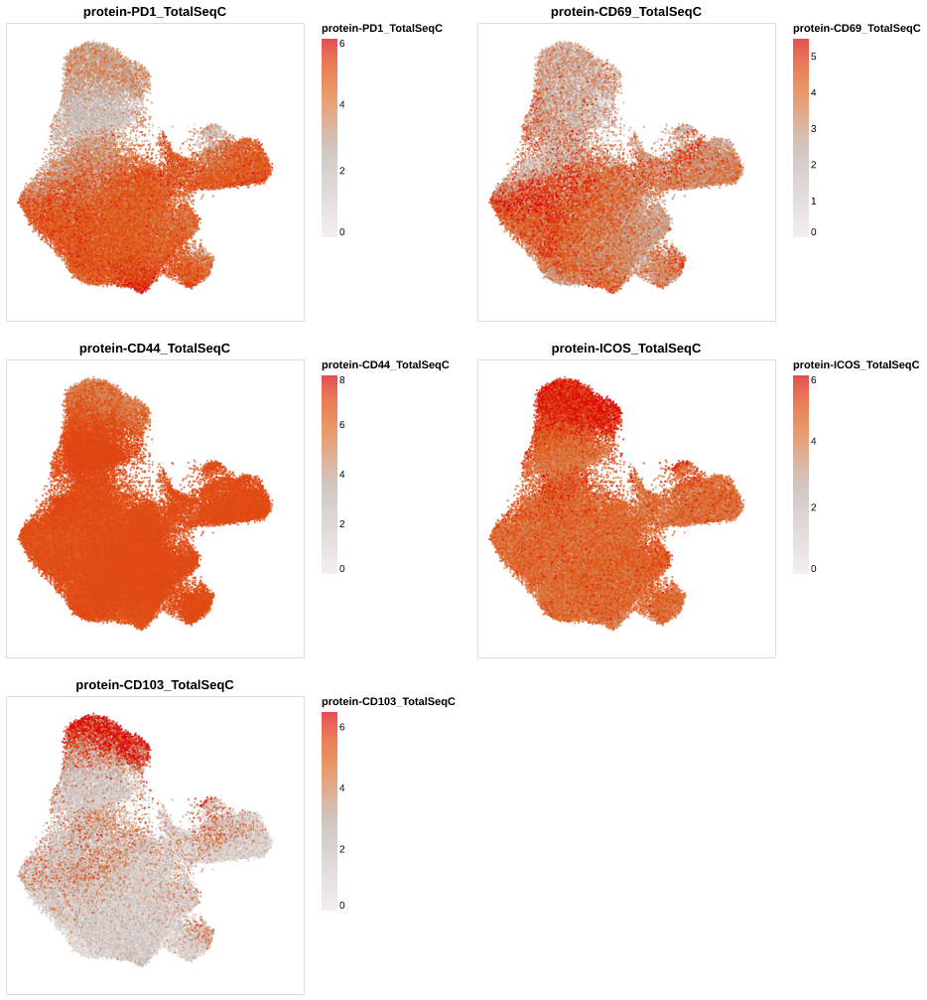

In [60]:
# Plotting protein on rna
plotdf = sc.get.obs_df(
    rna,
    obsm_keys=[("X_umap", i) for i in range(2)]
    + [("protein", i) for i in rna.obsm["protein"].columns],
)
(
    alt.concat(
        *map(
            partial(encode_color, umap_chart(plotdf), qdomain=(0, 0.95)),
            plotdf.columns[2:10],
        ),
        columns=2
    )
    .resolve_scale(color="independent")
    .configure_axis(grid=False)
)

In [61]:
rna

AnnData object with n_obs × n_vars = 72592 × 17581
    obs: 'adata_name', 'condition', 'batch_id', 'sample_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'rna_leiden', 'rna_leiden_05', 'is_outlier_counts', 'is_outlier_genes', 'is_outlier_top_20', 'is_outlier_mito', 'is_outlier', 'protein_leiden'
    var: 'gene_ids', 'feature_types', 'genome', 'pattern', 'read', 'sequence', 'mito', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'n_cells'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'rna_leiden', 'rna_leiden_0

### Clustering

In [62]:
def join_graphs_max(g1: "sparse.spmatrix", g2: "sparse.spmatrix"):
    """Take the maximum edge value from each graph."""
    out = g1.copy()
    mask = g1 < g2
    out[mask] = g2[mask]

    return out

In [63]:
rna.obsp["connectivities"] = join_graphs_max(
    rna.obsp["rna_connectivities"], rna.obsp["protein_connectivities"]
)

/home/kvalem/.local/lib/python3.11/site-packages/scipy/sparse/_index.py:151: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


In [64]:
sc.tl.leiden(rna, key_added="joint_leiden")

IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out


In [65]:
sc.tl.leiden(rna, key_added="joint_leiden_15", resolution=1.5)

IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out
IOStream.flush timed out


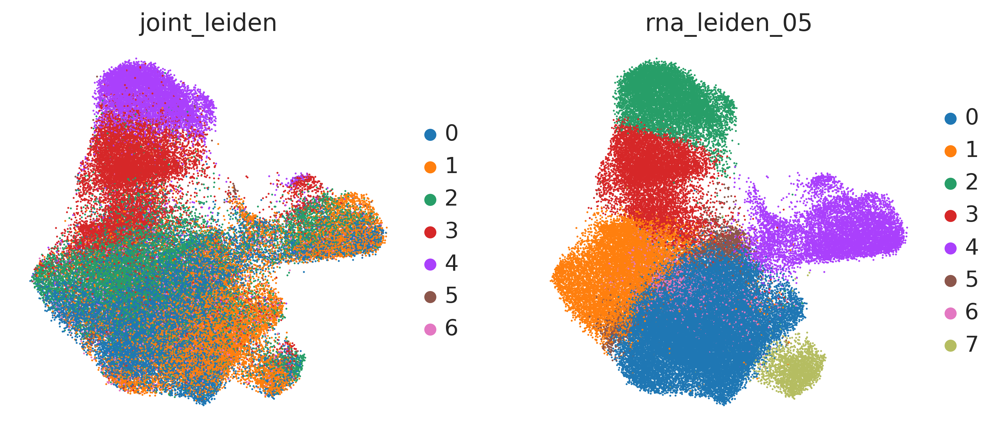

In [87]:
sc.pl.umap(rna, color=["joint_leiden","rna_leiden_05"], size=5)

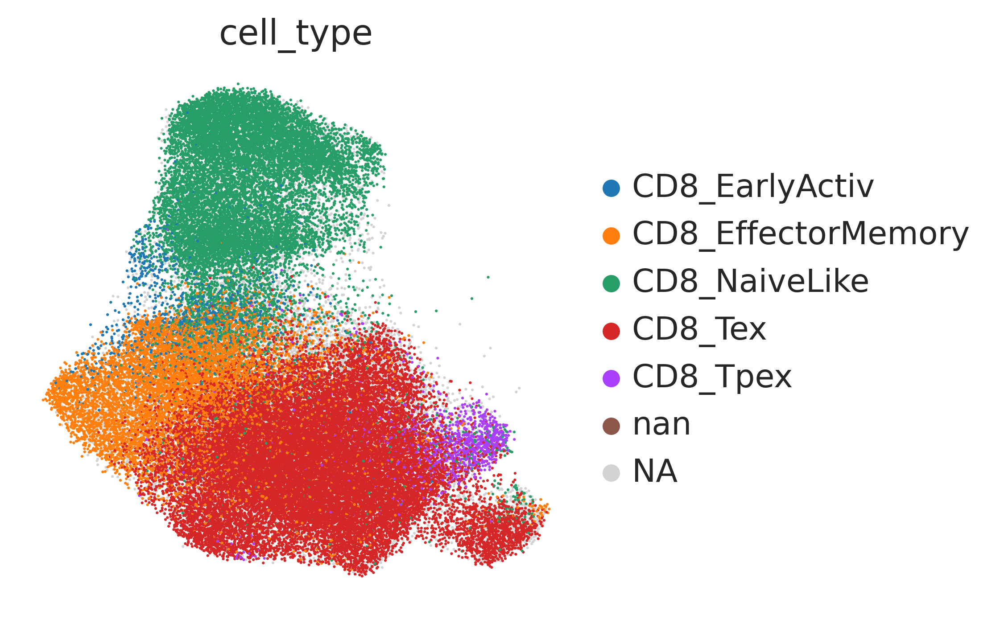

In [107]:
sc.pl.umap(rna, color=["cell_type"], size=5)

<Axes: title={'center': 'n_genes_by_counts'}, xlabel='UMAP1', ylabel='UMAP2'>

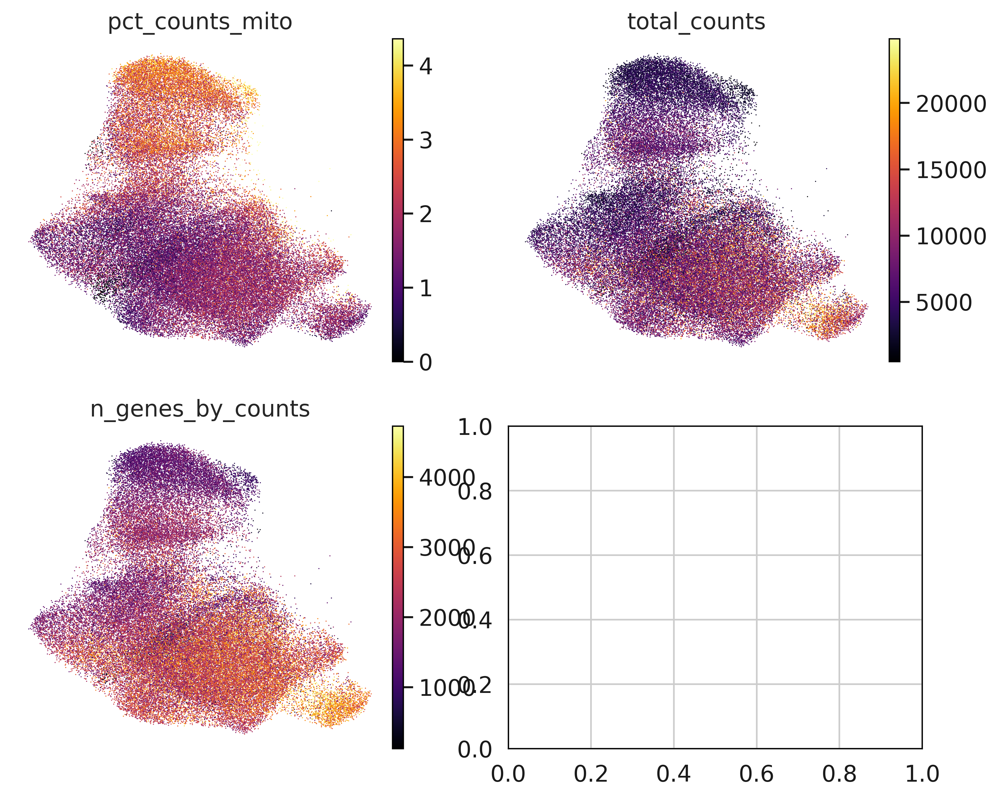

In [89]:
import matplotlib.pyplot as plt
fig, axes = plt.subplots(2, 2, figsize=(10, 8))
axes=axes.flatten()

sc.pl.umap(
    rna,
    color="pct_counts_mito",
    cmap="inferno",
    vmin=0,
    vmax="p99",
    sort_order=False,
    show=False,
    ax=axes[0],
)
sc.pl.umap(
    rna,
    color="total_counts",
    cmap="inferno",
    vmax="p99",
    sort_order=False,
    show=False,
    ax=axes[1],
)
sc.pl.umap(
    rna,
    color="n_genes_by_counts",
    cmap="inferno",
    vmax="p99",
    sort_order=False,
    show=False,
    ax=axes[2],
)


In [88]:
rna = rna[~rna.obs["rna_leiden_05"].isin(["4"])]

In [93]:
rna = rna[~rna.obs["cell_type"].isin(["nan"])]

In [101]:
rna.obs.cell_type.isnull().sum()

15992

In [96]:
rna.obs

,adata_name,condition,batch_id,sample_id,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_20_genes,total_counts_mito,...,rna_leiden_05,is_outlier_counts,is_outlier_genes,is_outlier_top_20,is_outlier_mito,is_outlier,protein_leiden,joint_leiden,joint_leiden_15,cell_type
AAACCTGAGAGCCTAG-1_10mix_ICI1,adata_10mix_ICI1,10mix,ICI1,10mix_ICI1,2513,7.829630,7829.0,8.965717,13.897049,70.0,...,0,False,False,False,False,False,26,0,18,CD8_Tex
AAACCTGAGATGTGGC-1_10mix_ICI1,adata_10mix_ICI1,10mix,ICI1,10mix_ICI1,3022,8.014005,11793.0,9.375346,17.001611,150.0,...,1,False,False,False,False,False,16,0,7,NaN
AAACCTGAGCCACGTC-1_10mix_ICI1,adata_10mix_ICI1,10mix,ICI1,10mix_ICI1,596,6.391917,1105.0,7.008505,30.588235,108.0,...,2,True,True,True,True,True,2,4,0,NaN
AAACCTGAGGCTCTTA-1_10mix_ICI1,adata_10mix_ICI1,10mix,ICI1,10mix_ICI1,1470,7.293698,3882.0,8.264363,19.500258,100.0,...,2,False,False,True,False,False,2,4,0,CD8_NaiveLike
AAACCTGAGGGCACTA-1_10mix_ICI1,adata_10mix_ICI1,10mix,ICI1,10mix_ICI1,2209,7.700748,7992.0,8.986321,18.018018,72.0,...,1,False,False,True,False,False,7,2,3,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTCATCCCTTGCA-1_GF_ICI2_plus,adata_GF_ICI2_plus,GF,ICI2,GF_ICI2_plus,2108,7.653969,6218.0,8.735364,15.937601,136.0,...,0,False,False,False,False,False,10,0,10,CD8_Tex
TTTGTCATCGTTGCCT-1_GF_ICI2_plus,adata_GF_ICI2_plus,GF,ICI2,GF_ICI2_plus,4821,8.480944,25856.0,10.160336,14.948175,493.0,...,0,True,True,False,False,True,6,0,12,CD8_Tex
TTTGTCATCTAACTGG-1_GF_ICI2_plus,adata_GF_ICI2_plus,GF,ICI2,GF_ICI2_plus,1685,7.430114,3886.0,8.265393,13.767370,73.0,...,1,True,False,True,False,True,11,0,9,CD8_Tex
TTTGTCATCTCTGTCG-1_GF_ICI2_plus,adata_GF_ICI2_plus,GF,ICI2,GF_ICI2_plus,2101,7.650645,6973.0,8.849944,17.453033,170.0,...,1,False,False,False,False,False,15,2,6,CD8_Tex


In [67]:
adata_final_annotation = sc.read_h5ad(
    "/data/projects/2021/MicrobialMetabolites/single-cell-sorted-cd8/results/40_gex_surface_prot/13_january_2025/mapped_data/mapped_til_colon.h5ad"
)

In [102]:
adata_final_annotation.obs.cell_type.value_counts()

cell_type
CD8_Tex               27346
CD8_NaiveLike         19281
CD8_EffectorMemory     8219
CD8_EarlyActiv         3513
CD8_Tpex               1095
nan                    1005
Name: count, dtype: int64

In [108]:
rna.obs.cell_type.value_counts()

cell_type
CD8_Tex               23571
CD8_NaiveLike         13861
CD8_EffectorMemory     8121
CD8_EarlyActiv         1117
CD8_Tpex               1078
nan                       0
Name: count, dtype: int64

In [75]:
adata_final_annotation.obs.index = adata_final_annotation.obs.index.str.replace("_", "-", n=1)

In [76]:
rna.obs["cell_type"] = adata_final_annotation.obs["cell_type"]

In [106]:
rna.obs["cell_type"] = adata_final_annotation.obs["cell_type"].reindex(rna.obs.index)

/tmp/ipykernel_3020354/458323358.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  rna.obs["cell_type"] = adata_final_annotation.obs["cell_type"].reindex(rna.obs.index)


In [80]:
rna

AnnData object with n_obs × n_vars = 72592 × 17581
    obs: 'adata_name', 'condition', 'batch_id', 'sample_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'rna_leiden', 'rna_leiden_05', 'is_outlier_counts', 'is_outlier_genes', 'is_outlier_top_20', 'is_outlier_mito', 'is_outlier', 'protein_leiden', 'joint_leiden', 'joint_leiden_15', 'cell_type'
    var: 'gene_ids', 'feature_types', 'genome', 'pattern', 'read', 'sequence', 'mito', 'ribo', 'hb', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection', 'n_cells'
    uns: 'log1p', 'hvg', 'pca', 

### Gather data

In [ ]:
adata

In [ ]:
sc.pp.filter_genes(adata, min_cells=10)

In [ ]:
adata

In [ ]:
rna

In [ ]:
rna.X

In [ ]:
adata.X[:,(adata.var["feature_types"]=="Gene Expression").values]

In [ ]:
adata.X[:,(adata.var["feature_types"]=="Gene Expression").values] = rna.X

In [ ]:
adata.X[:,(adata.var["feature_types"]=="Antibody Capture").values] = protein.X

In [ ]:
adata.X[:,(adata.var["feature_types"]=="Antibody Capture").values] = protein.X

In [ ]:
adata.obs

In [ ]:
rna.obs

In [ ]:
adata.obsm.update(rna.obsm)

In [ ]:
adata.obs[rna.obs.columns] = rna.obs

In [ ]:
adata

### Labelling

In [ ]:
sc.pl.umap(adata, color= ["joint_leiden","sample_id"])

In [ ]:
adata

In [ ]:
## sp
adata.obs["is_outlier_counts"] = ah.pp.is_outlier(
    adata, "log1p_total_counts", n_mads=1.5, groupby="sample_id"
)
adata.obs["is_outlier_genes"] = ah.pp.is_outlier(
    adata, "log1p_n_genes_by_counts", n_mads=1.5, groupby="sample_id"
)
adata.obs["is_outlier_top_20"] = ah.pp.is_outlier(
    adata, "pct_counts_in_top_20_genes", n_mads=1.5, groupby="sample_id"
)
adata.obs["is_outlier_mito"] = ah.pp.is_outlier(
    adata, "pct_counts_mito", n_mads=3, groupby="sample_id"
)

adata.obs["is_outlier"] = (
    np.sum(
        rna.obs.loc[
            :,
            [
                "is_outlier_counts",
                "is_outlier_genes",
                "is_outlier_top_20",
                "is_outlier_mito",
            ],
        ],
        axis=1,
    )
    >= 2
)

In [ ]:
adata_filtered = adata[~adata.obs["is_outlier"]].copy()

In [ ]:
adata

In [ ]:
adata_filtered

In [ ]:
adata = adata_filtered

### Subset adata bottom part check markers and integrate back

In [ ]:
sc.pl.umap(adata, color= ["joint_leiden","sample_id"])

## Cell type annotation from marker genes

### Marker genes

* Tissue Resident Memory T (TRM) 
CD103 
- https://www.ncbi.nlm.nih.gov/pmc/articles/PMC6104123/

- ICOS

 https://pubmed.ncbi.nlm.nih.gov/34932944/

 Cycling CD8+ T 
-  Mki67 +

-  T cell subset
-  https://www.ncbi.nlm.nih.gov/pmc/articles/PMC7115982/

In [ ]:
# Markers from publication doi: 10.1038/s41568-019-0235-4
#CD8+ T cell states in human cancer: insights from single-cell analysis
# Reference study: Zhang (CRC) Human 
naive_markers = ["Lef1","Sell","Ccr7","Tcf7","Cd27","Cd28","S1pr1"] # Naive-like
effector_memory_markers = ["Gzmk","Cxcr4","Cxcr3","Cd44"] #Predysfunctional
exhausted_markers = ["Havcr2","Pdcd1","Ifng","Itgae"] #  Dysfunctional #Layn, Cxcl13 not found
activated_effector_memory_marker  = ["Cx3cr1","Klrg1","Prf1","Tbx21","Eomes","S1pr1","S1pr5"] # Temra, #Cytotoxic #not found "Fcgr3a","Fgfbp2""Gzmh"

#* not described in table 1 
central_memory_markers = ["Gpr183","Ccr7","Sell","Il7r","Cd27","Cd28","Gzma","Ccl5","S1pr1","Gzma"] # not described in table 1 
tissue_resident_memory_markers = ["Cd6","Myadm","Capg","Rora","Nr4a1","Nr4a2","Nr4a3","Cd69","Itgae"] # not described in table 1  #not found "Cxcl1" ,"Xcl2"

#**Tumour type-specific T cell subsets that are not included in Table 1
intraepitheliel_lymphocytes_markers = ["Cd160","Klrc1","Klrc2","Klrc3","Ikzf2","Entpd1","Cd69","Itgae","Nr4a1","Nr4a2"] #IEL #"Kir2dl4","Timigd2"
mucosal_associated_invariant_markers = ["Slc4a10","Zbtb16","Klrb1","Rora"] # MAIT # not found "Rorc"

In [ ]:
# Plotting protein on rna
plotdf = sc.get.obs_df(
    rna,
    obsm_keys=[("X_umap", i) for i in range(2)]
    + [("protein", i) for i in rna.obsm["protein"].columns],
)
(
    alt.concat(
        *map(
            partial(encode_color, umap_chart(plotdf), qdomain=(0, 0.95)),
            plotdf.columns[2:10],
        ),
        columns=2
    )
    .resolve_scale(color="independent")
    .configure_axis(grid=False)
)

In [ ]:
sc.pl.umap(adata, color=exhausted_markers,
    cmap="Reds",
    vmin=0,
    vmax="p99",
    sort_order=False,
    show=False)

In [ ]:
ax = sc.pl.dotplot(adata, exhausted_markers, groupby='joint_leiden', log=True)

In [ ]:
#Early disfunciton markers https://www.nature.com/articles/s41577-021-00574-3/figures/2 
sc.pl.umap(adata, color=["Lag3","Cd38","Entpd1","Havcr2","Tox","Gzmk"],
    cmap="Reds",
    vmin=0,
    vmax="p99",
    sort_order=False,
    show=False)

In [ ]:
ax = sc.pl.dotplot(adata, ["Lag3","Cd38","Entpd1","Havcr2","Tox","Gzmk"], groupby='joint_leiden', log=True)

In [ ]:
sc.pl.umap(adata, color=central_memory_markers,
    cmap="Reds",
    vmin=0,
    vmax="p99",
    sort_order=False,
    show=False)

In [ ]:
ax = sc.pl.dotplot(adata, central_memory_markers, groupby='joint_leiden', log=True)

In [ ]:
#tissue_resident_memory_markers
mks =  ["Cd3e","Itgae","Cd8a","Zfp683","Ifng","Gzma","Gzmb","Prf1","Pdcd1","Ctla4","Havcr2","Lag3"] #https://www.nature.com/articles/s41416-023-02202-4/figures/2
sc.pl.umap(adata, color=mks,
    cmap="Reds",
    vmin=0,
    vmax="p99",
    sort_order=False,
    show=False)

In [ ]:
ax = sc.pl.dotplot(adata, ["Cd3e","Itgae","Cd8a","Zfp683","Ifng","Gzma","Gzmb","Prf1","Pdcd1","Ctla4","Havcr2","Lag3"], groupby='joint_leiden', log=True)

### Annotate

In [ ]:
sc.pl.umap(adata, color='joint_leiden')

In [ ]:
annotation_dict = {
    '0':'Exhasuted/Early to late dysfunctional',
    '1':'Exhasuted/Early to late dysfunctional',
    '2':'Exhasuted/Early to late dysfunctional',
    '3':'Trm/Tcm/Naive/CTL',
    '4':'Trm/Tcm/Naive/CTL',
    '5':'Exhasuted/Early to late dysfunctional',
    '6':'Exhasuted/Early to late dysfunctional'}

In [ ]:
## Add cell type column based on annotation
adata.obs['cell_type'] = [annotation_dict[clust] for clust in adata.obs['joint_leiden']]

# Visualize
sc.pl.umap(adata, color='cell_type')

In [ ]:
#adata.write_h5ad(f"{resDir}/adata_merged_til_annotated.h5ad")

In [ ]:
adata.write_h5ad(f"{resDir}/adata_merged_til_annotated_new.h5ad")